In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import os

folder_path = '/content/drive/My Drive/RM_Segmentation_Assignment_dataset'

if os.path.exists(folder_path):
  print(f"Contents of '{folder_path}':")
  for item in os.listdir(folder_path):
    print(item)
else:
  print(f"Folder not found: '{folder_path}'")

Contents of '/content/drive/My Drive/RM_Segmentation_Assignment_dataset':
validation-300
test-30
train-300
train-300-filtered.json
validation-300-filtered.json


In [4]:
import json

train_json_path = '/content/drive/My Drive/RM_Segmentation_Assignment_dataset/train-300/labels.json'
val_json_path = '/content/drive/My Drive/RM_Segmentation_Assignment_dataset/validation-300/labels.json'

with open(train_json_path) as f:
    train_labels = json.load(f)

with open(val_json_path) as f:
    val_labels = json.load(f)


In [5]:
train_categories = train_labels['categories']
print(f"Total categories: {len(train_categories)}")
print("Sample categories:")
for cat in train_categories[:10]:
    print(cat)


Total categories: 63
Sample categories:
{'id': 0, 'name': 'airplane', 'supercategory': 'vehicle'}
{'id': 1, 'name': 'backpack', 'supercategory': 'accessory'}
{'id': 2, 'name': 'banana', 'supercategory': 'food'}
{'id': 3, 'name': 'baseball bat', 'supercategory': 'sports'}
{'id': 4, 'name': 'baseball glove', 'supercategory': 'sports'}
{'id': 5, 'name': 'bear', 'supercategory': 'animal'}
{'id': 6, 'name': 'bench', 'supercategory': 'outdoor'}
{'id': 7, 'name': 'bicycle', 'supercategory': 'vehicle'}
{'id': 8, 'name': 'bird', 'supercategory': 'animal'}
{'id': 9, 'name': 'boat', 'supercategory': 'vehicle'}


In [6]:
target_class_names = ['cake', 'car', 'dog', 'person']

id_to_name = {cat['id']: cat['name'].lower() for cat in train_labels['categories']}
name_to_id = {v: k for k, v in id_to_name.items()}

target_category_ids = {name_to_id[name] for name in target_class_names}
print("Target category IDs:", target_category_ids)

Target category IDs: {16, 25, 41, 15}


In [7]:
target_class_names = ['cake', 'car', 'dog', 'person']

val_id_to_name = {cat['id']: cat['name'].lower() for cat in val_labels['categories']}
val_name_to_id = {v: k for k, v in val_id_to_name.items()}

val_target_category_ids = {val_name_to_id[name] for name in target_class_names}
print("Target category IDs:", val_target_category_ids)

Target category IDs: {24, 41, 14, 15}


In [8]:
filtered_annotations = [
    ann for ann in train_labels['annotations']
    if ann['category_id'] in target_category_ids
]


In [9]:
valid_image_ids = {ann['image_id'] for ann in filtered_annotations}

filtered_images = [
    img for img in train_labels['images']
    if img['id'] in valid_image_ids
]


In [10]:
filtered_train_labels = {
    'info': train_labels['info'],
    'licenses': train_labels['licenses'],
    'categories': [cat for cat in train_labels['categories'] if cat['id'] in target_category_ids],
    'images': filtered_images,
    'annotations': filtered_annotations
}

import os
output_path = '/content/drive/My Drive/RM_Segmentation_Assignment_dataset/train-300-filtered.json'
with open(output_path, 'w') as f:
    json.dump(filtered_train_labels, f)


In [11]:
filtered_val_annotations = [
    ann for ann in val_labels['annotations']
    if ann['category_id'] in val_target_category_ids
]


In [12]:
valid_val_image_ids = {ann['image_id'] for ann in filtered_val_annotations}

filtered_val_images = [
    img for img in val_labels['images']
    if img['id'] in valid_val_image_ids
]


In [13]:
filtered_val_labels = {
    'info': val_labels['info'],
    'licenses': val_labels['licenses'],
    'categories': [cat for cat in val_labels['categories'] if cat['id'] in target_category_ids],
    'images': filtered_val_images,
    'annotations': filtered_val_annotations
}

output_val_path = '/content/drive/My Drive/RM_Segmentation_Assignment_dataset/validation-300-filtered.json'
with open(output_val_path, 'w') as f:
    json.dump(filtered_val_labels, f)


In [14]:
from collections import defaultdict

def analyze_class_coverage(annotations, categories):
    id_to_name = {cat['id']: cat['name'].lower() for cat in categories}
    image_class_map = defaultdict(set)

    for ann in annotations:
        cat_id = ann['category_id']
        class_name = id_to_name.get(cat_id)
        if class_name:
            image_class_map[ann['image_id']].add(class_name)

    return image_class_map

In [15]:
def summarize_class_coverage(image_class_map):
    coverage_count = defaultdict(int)

    for img_id, class_set in image_class_map.items():
        coverage_count[len(class_set)] += 1

    for i in sorted(coverage_count):
        print(f"{coverage_count[i]} images have {i} of the 4 target classes")

train_class_map = analyze_class_coverage(filtered_train_labels['annotations'], filtered_train_labels['categories'])
print("Training Set Coverage:")
summarize_class_coverage(train_class_map)

val_class_map = analyze_class_coverage(filtered_val_labels['annotations'], filtered_val_labels['categories'])
print("\nValidation Set Coverage:")
summarize_class_coverage(val_class_map)


Training Set Coverage:
44 images have 1 of the 4 target classes
246 images have 2 of the 4 target classes
10 images have 3 of the 4 target classes

Validation Set Coverage:
139 images have 1 of the 4 target classes
161 images have 2 of the 4 target classes


In [16]:
from collections import Counter

def get_class_counts(annotations, categories):
    id_to_name = {cat['id']: cat['name'].lower() for cat in categories}
    class_counter = Counter()

    for ann in annotations:
        class_name = id_to_name.get(ann['category_id'])
        if class_name:
            class_counter[class_name] += 1

    return class_counter

In [17]:
train_counts = get_class_counts(filtered_train_labels['annotations'], filtered_train_labels['categories'])
val_counts = get_class_counts(filtered_val_labels['annotations'], filtered_val_labels['categories'])

print("Train Class Frequencies:")
for cls, count in train_counts.items():
    print(f"{cls:10s}: {count}")

print("\nValidation Class Frequencies:")
for cls, count in val_counts.items():
    print(f"{cls:10s}: {count}")

Train Class Frequencies:
person    : 1350
car       : 1061
dog       : 14
cake      : 13

Validation Class Frequencies:
car       : 861
person    : 1191


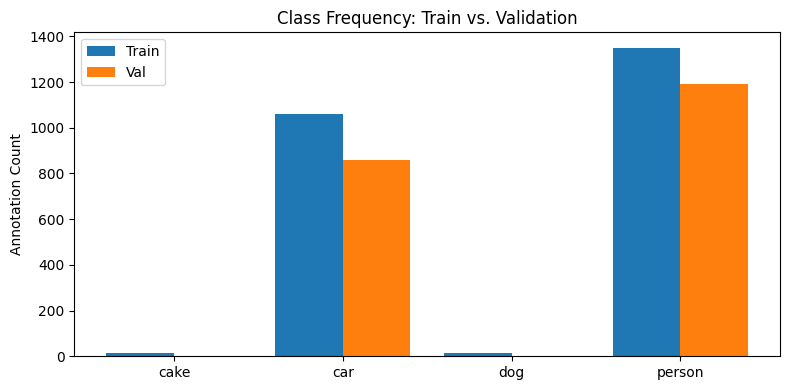

In [15]:
import matplotlib.pyplot as plt

def plot_class_counts(train_counts, val_counts):
    classes = sorted(set(train_counts.keys()).union(val_counts.keys()))

    train_vals = [train_counts.get(cls, 0) for cls in classes]
    val_vals = [val_counts.get(cls, 0) for cls in classes]

    x = range(len(classes))
    plt.figure(figsize=(8, 4))
    plt.bar(x, train_vals, width=0.4, label='Train', align='center')
    plt.bar([i + 0.4 for i in x], val_vals, width=0.4, label='Val', align='center')
    plt.xticks([i + 0.2 for i in x], classes)
    plt.ylabel('Annotation Count')
    plt.title('Class Frequency: Train vs. Validation')
    plt.legend()
    plt.tight_layout()
    plt.show()

plot_class_counts(train_counts, val_counts)


In [16]:
import numpy as np

def image_size_stats(images):
    widths = [img['width'] for img in images]
    heights = [img['height'] for img in images]

    print(f"Total images: {len(images)}")
    print(f"Width  - min: {np.min(widths)}, max: {np.max(widths)}, mean: {np.mean(widths):.1f}")
    print(f"Height - min: {np.min(heights)}, max: {np.max(heights)}, mean: {np.mean(heights):.1f}")

image_size_stats(filtered_train_labels['images'])
image_size_stats(filtered_val_labels['images'])


Total images: 300
Width  - min: 333, max: 640, mean: 595.3
Height - min: 270, max: 640, mean: 475.4
Total images: 300
Width  - min: 299, max: 640, mean: 591.9
Height - min: 246, max: 640, mean: 482.9


In [17]:
import matplotlib.pyplot as plt
import cv2
import random
import numpy as np
from collections import defaultdict
import os

def show_sample_with_mask(filtered_labels, image_dir):
    id_to_name = {cat['id']: cat['name'] for cat in filtered_labels['categories']}

    image_id_to_image = {img['id']: img for img in filtered_labels['images']}
    image_id_to_anns = defaultdict(list)
    for ann in filtered_labels['annotations']:
        image_id_to_anns[ann['image_id']].append(ann)

    image_id = random.choice(list(image_id_to_anns.keys()))
    image_info = image_id_to_image[image_id]
    anns = image_id_to_anns[image_id]

    image_path = os.path.join(image_dir, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(8, 6))
    plt.imshow(image)

    for ann in anns:
        for seg in ann['segmentation']:
            seg_np = np.array(seg).reshape(-1, 2)
            plt.plot(seg_np[:, 0], seg_np[:, 1], linewidth=2)

    class_names = [id_to_name[ann['category_id']] for ann in anns]
    plt.title(f"Image ID: {image_id} | Classes: {class_names}")
    plt.axis('off')
    plt.show()


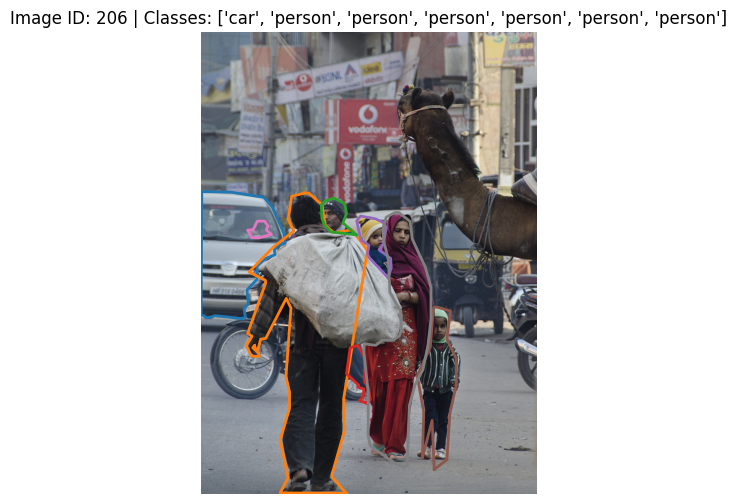

In [18]:
train_image_dir = '/content/drive/My Drive/RM_Segmentation_Assignment_dataset/train-300/data'
show_sample_with_mask(filtered_train_labels, train_image_dir)


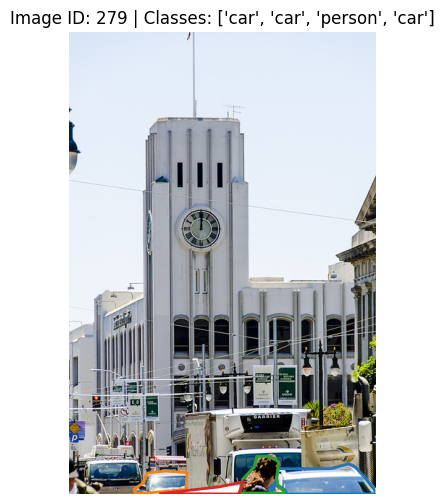

In [19]:
val_image_dir = '/content/drive/My Drive/RM_Segmentation_Assignment_dataset/validation-300/data'
show_sample_with_mask(filtered_val_labels, val_image_dir)


In [20]:
import torch
from torch.utils.data import Dataset
import os
import json
import cv2
import numpy as np
from torchvision import transforms

class CocoSegmentationDataset(Dataset):
    def __init__(self, data_dir, label_json, category_ids, transform=None):
        with open(label_json, 'r') as f:
            labels = json.load(f)

        self.image_dir = os.path.join(data_dir, "data")
        self.images = labels['images']
        self.annotations = labels['annotations']
        self.categories = labels['categories']
        self.transform = transform
        self.category_ids = category_ids

        self.image_id_to_anns = {}
        for ann in self.annotations:
            if ann['category_id'] in self.category_ids:
                self.image_id_to_anns.setdefault(ann['image_id'], []).append(ann)

        self.images = [img for img in self.images if img['id'] in self.image_id_to_anns]

        self.cat_to_idx = {cat_id: idx for idx, cat_id in enumerate(category_ids)}

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_info = self.images[idx]
        img_path = os.path.join(self.image_dir, img_info['file_name'])
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        H, W = img_info['height'], img_info['width']

        mask = np.zeros((H, W), dtype=np.uint8)

        for ann in self.image_id_to_anns[img_info['id']]:

          for seg in ann['segmentation']:
              if not isinstance(seg, list) or len(seg) < 6:
                  continue
              try:
                  pts = np.array(seg).reshape(-1, 2).astype(np.int32)
              except ValueError:
                  continue

              cv2.fillPoly(mask, [pts], color=self.cat_to_idx[ann['category_id']])

        if self.transform:
            aug = self.transform(image=image, mask=mask)
            image = aug['image']
            mask = aug['mask']

        return image, mask.long()


In [21]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose([
    A.Resize(512, 512),
    A.HorizontalFlip(p=0.5),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

val_transform = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])


In [22]:
from torch.utils.data import DataLoader

category_ids = [cat['id'] for cat in filtered_train_labels['categories']]

train_dataset = CocoSegmentationDataset(
    data_dir='/content/drive/My Drive/RM_Segmentation_Assignment_dataset/train-300',
    label_json='/content/drive/My Drive/RM_Segmentation_Assignment_dataset/train-300-filtered.json',
    category_ids=category_ids,
    transform=train_transform
)

val_dataset = CocoSegmentationDataset(
    data_dir='/content/drive/My Drive/RM_Segmentation_Assignment_dataset/validation-300',
    label_json='/content/drive/My Drive/RM_Segmentation_Assignment_dataset/validation-300-filtered.json',
    category_ids=category_ids,
    transform=val_transform
)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=2)


In [23]:
import torchvision
from torchvision.models.segmentation import deeplabv3_resnet50

model = deeplabv3_resnet50(pretrained=True)
model.classifier[4] = torch.nn.Conv2d(256, 4, kernel_size=1)
model = model.cuda()


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/deeplabv3_resnet50_coco-cd0a2569.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet50_coco-cd0a2569.pth
100%|██████████| 161M/161M [00:01<00:00, 118MB/s]


In [24]:
import torch.nn as nn
import torch.optim as optim

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

for epoch in range(10):
    model.train()
    running_loss = 0
    for imgs, masks in train_loader:
        imgs, masks = imgs.to(device), masks.to(device)
        outputs = model(imgs)['out']
        loss = criterion(outputs, masks)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

    print(f"Epoch [{epoch+1}] Loss: {running_loss / len(train_loader):.4f}")


Epoch [1] Loss: 0.7903
Epoch [2] Loss: 0.4075
Epoch [3] Loss: 0.2620
Epoch [4] Loss: 0.2040
Epoch [5] Loss: 0.1704
Epoch [6] Loss: 0.1566
Epoch [7] Loss: 0.1267
Epoch [8] Loss: 0.1014
Epoch [9] Loss: 0.0901
Epoch [10] Loss: 0.0784


In [50]:
from torch.utils.data import Dataset
from PIL import Image
import albumentations as A
from albumentations.pytorch import ToTensorV2
import os

class UnlabeledImageDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_dir = os.path.join(image_dir)
        self.image_files = sorted(os.listdir(self.image_dir))
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_path = os.path.join(self.image_dir, self.image_files[idx])
        image = np.array(Image.open(image_path).convert("RGB"))

        if self.transform:
            image = self.transform(image=image)['image']

        return image, self.image_files[idx]


In [51]:
test_transform = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

test_image_dir = '/content/drive/My Drive/RM_Segmentation_Assignment_dataset/test-30'

test_dataset = UnlabeledImageDataset(image_dir=test_image_dir, transform=test_transform)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)


In [54]:
def visualize_test_predictions(model, dataloader, device, label_names):
    model.eval()
    with torch.no_grad():
        for i, (img, filename) in enumerate(dataloader):
            img = img.to(device)
            output = model(img)['out']
            pred_mask = torch.argmax(output.squeeze(), dim=0).cpu().numpy()

            img_np = img.squeeze().cpu().permute(1, 2, 0).numpy()
            img_np = (img_np * [0.229, 0.224, 0.225]) + [0.485, 0.456, 0.406]
            img_np = np.clip(img_np, 0, 1)

            unique_classes = np.unique(pred_mask)
            predicted_class_names = [label_names[c] for c in unique_classes if c < len(label_names)]
            plt.figure(figsize=(10, 5))

            plt.subplot(1, 2, 1)
            plt.imshow(img_np)
            plt.title(f"Original: {filename[0]}")
            plt.axis("off")

            plt.subplot(1, 2, 2)
            plt.imshow(pred_mask, cmap="tab10", vmin=0, vmax=len(label_names) - 1)
            plt.title(f"Predicted: {', '.join(predicted_class_names)}")
            plt.axis("off")

            plt.tight_layout()
            plt.show()

            if i >= 30:
                break


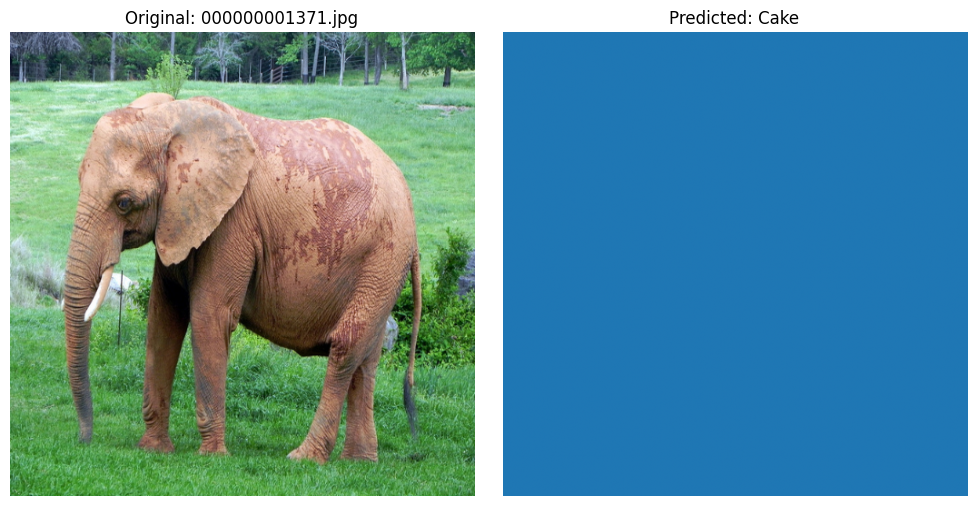

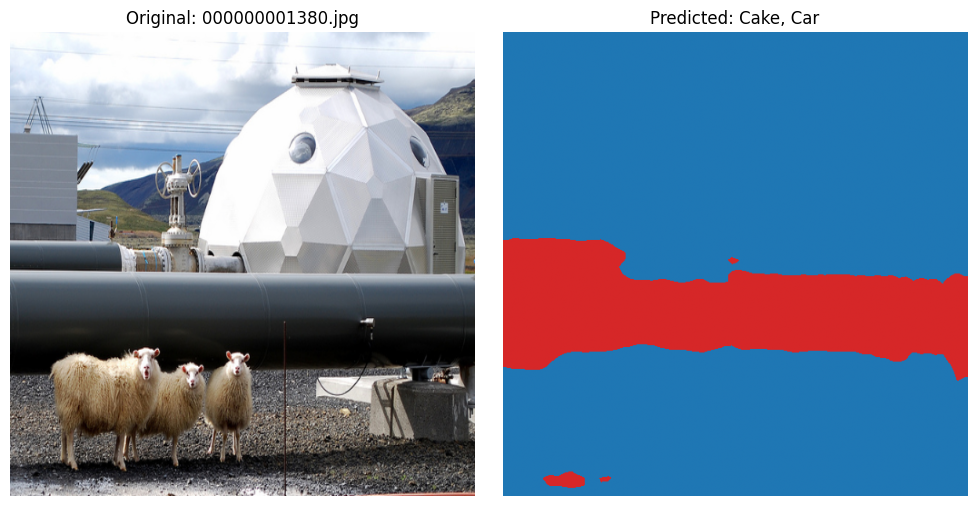

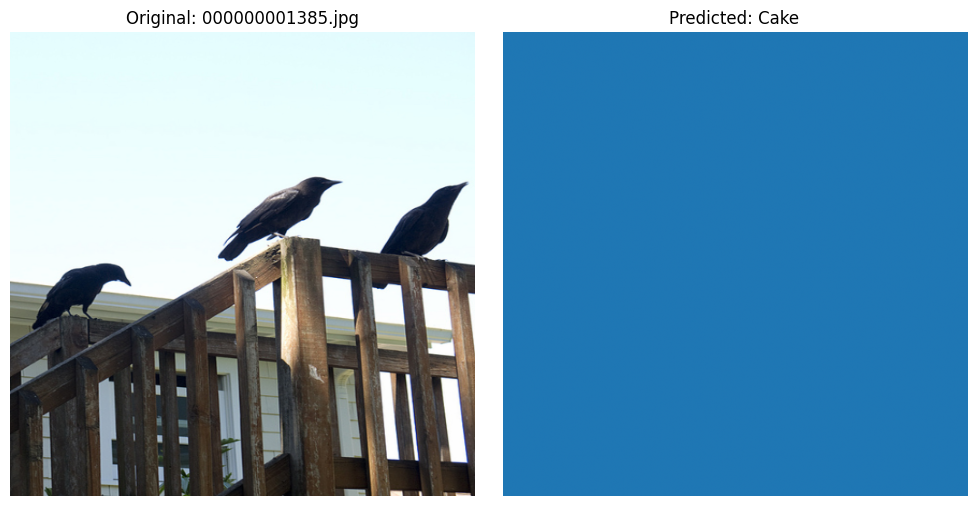

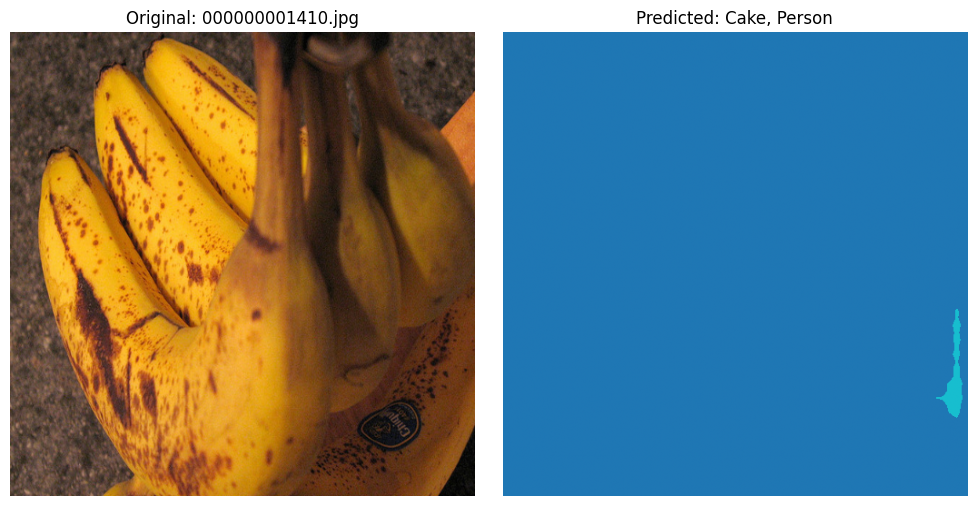

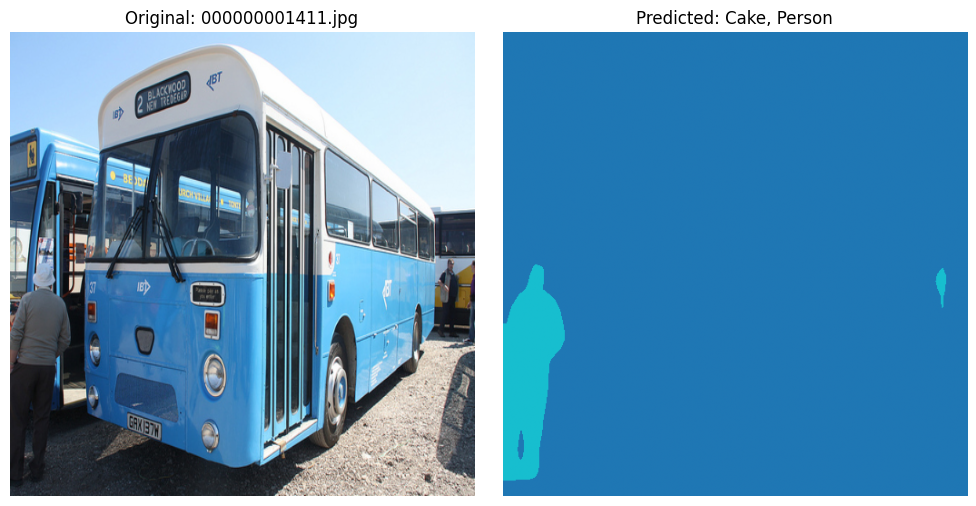

...

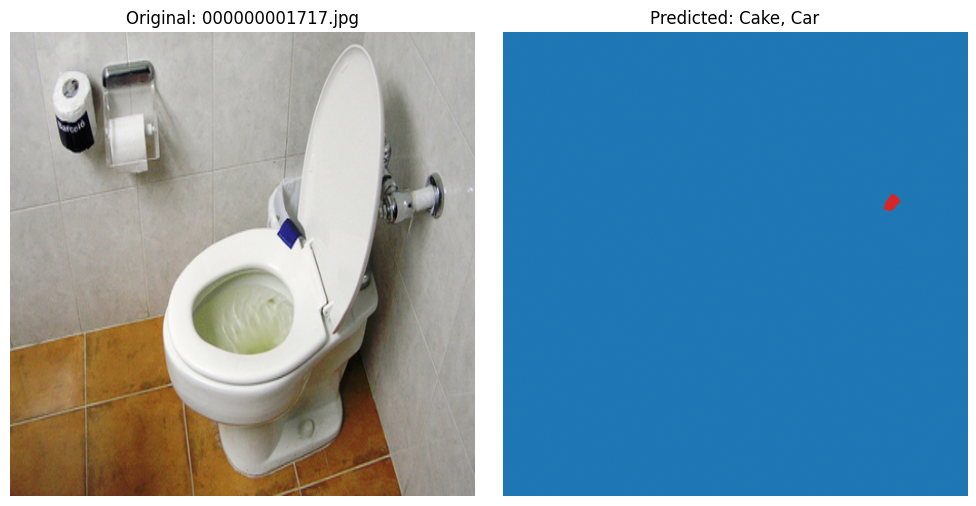

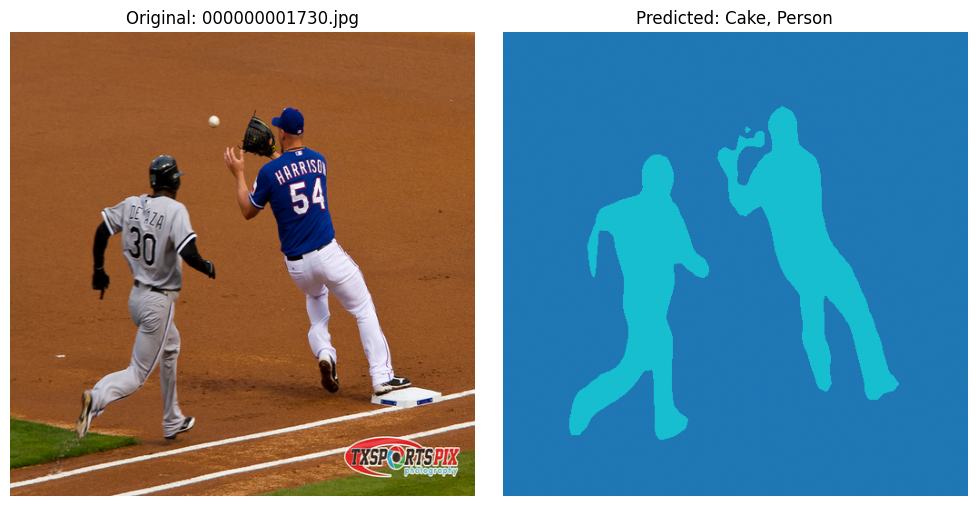

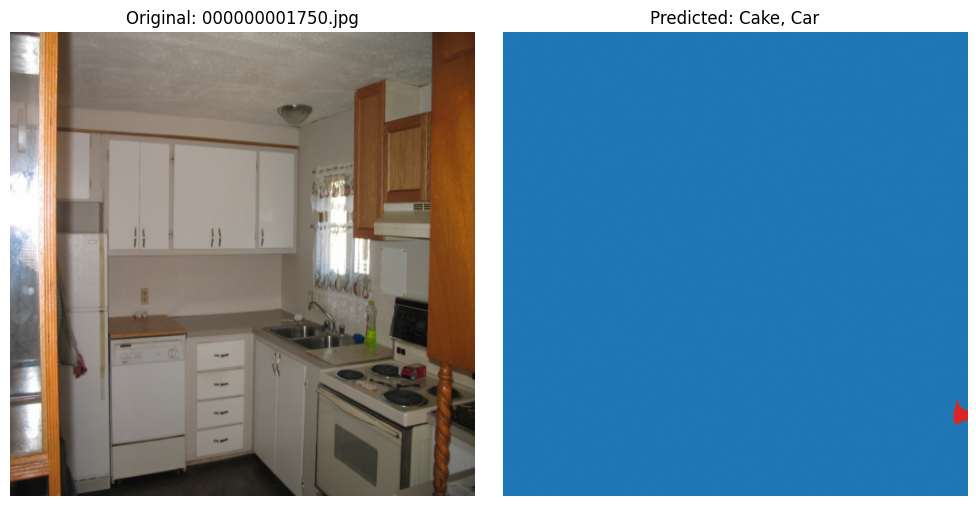

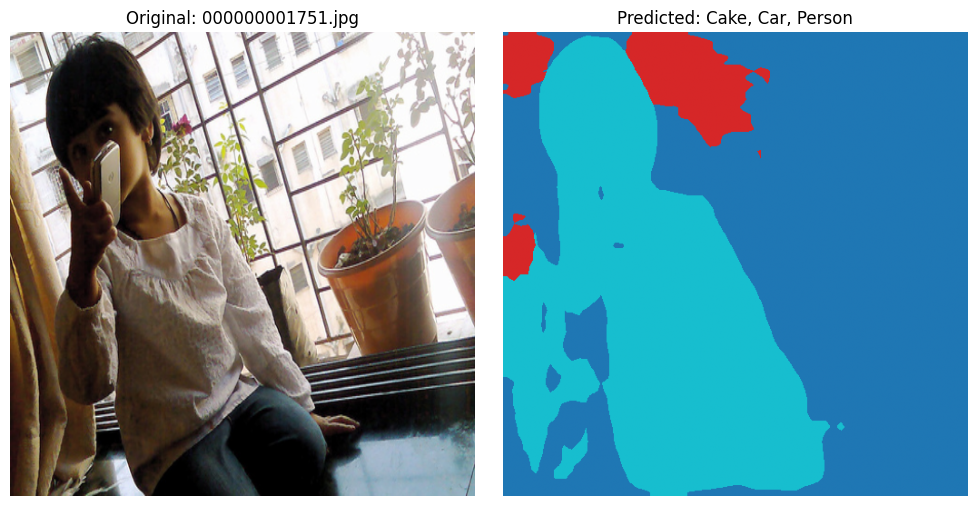

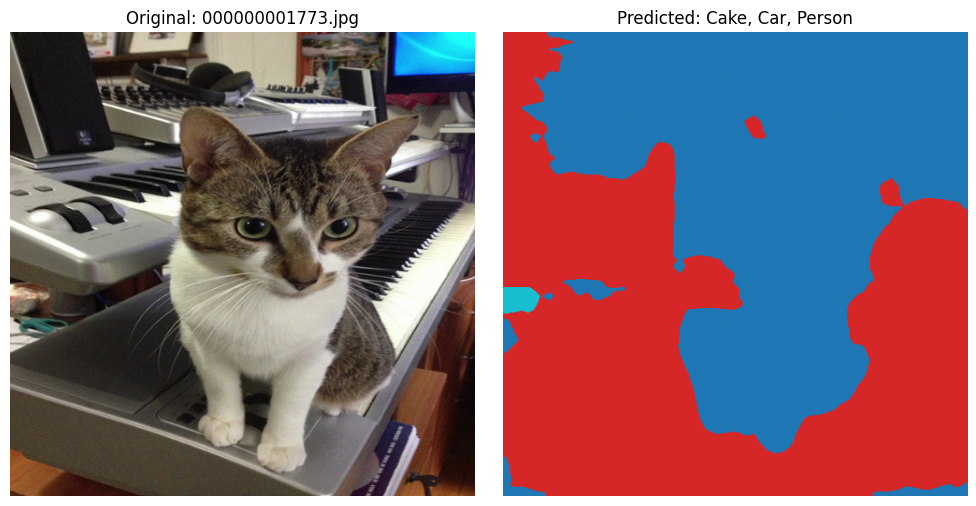

IsADirectoryError: [Errno 21] Is a directory: '/content/drive/My Drive/RM_Segmentation_Assignment_dataset/test-30/predictions'

In [55]:
label_names = ['Cake', 'Car', 'Dog', 'Person']
visualize_test_predictions(model, test_loader, device, label_names)
